In [1]:
import tensorflow as tf
import time
import os
import numpy as np
import matplotlib.pyplot as plt
plt.style.use("ggplot")
from tqdm import tqdm
# import tifffile
import cv2
import tifffile
image_counter = 0

2023-07-19 23:36:23.166211: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))
print(tf.version)

Found GPU at: /device:GPU:0
<module 'tensorflow._api.v2.version' from '/data/software/python-libs/3.0.0/envs/tensorflow-2.11-gpu/lib/python3.9/site-packages/tensorflow/_api/v2/version/__init__.py'>


2023-07-19 23:36:28.016701: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-19 23:36:28.990363: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1613] Created device /device:GPU:0 with 30966 MB memory:  -> device: 0, name: Tesla V100S-PCIE-32GB, pci bus id: 0000:c3:00.0, compute capability: 7.0


In [3]:
# Set some parameters
im_width = 512
im_height = 512
channels_img = 3
channels_mask = 3

path_train_pots = 'Selected_Images/Subset_Clipped_Potsdam/IrRG/'
path_mask_pots = 'Selected_Images/Subset_Clipped_Potsdam/Mask/'

path_train_vai = 'Selected_Images/Subset_Clipped_Vaihingen/IrRG/'
path_mask_vai =  'Selected_Images/Subset_Clipped_Vaihingen/Mask/'

OUTPUT_CHANNELS = 6
BATCH_SIZE = 8
#Batch_SIZE adjustment ==> was 15
EPOCHS = 500
model_size = 64
BUFFER_SIZE = 100
output_path = 'CGAN_P2V/with TV/'

print(path_train_pots)
print(path_train_vai)

Selected_Images/Subset_Clipped_Potsdam/IrRG/
Selected_Images/Subset_Clipped_Vaihingen/IrRG/


In [4]:
###########################################################################
#Load the image data, mask data and unique RGB values in the mask data.#####
############################################################################


def get_data(path_train, path_mask, train=True):
    ##This line of the program extracts unique values in each RGB image and does it repeatedly for all images. 
    temp_unique_list=[]
    ids = next(os.walk(path_train))[2]
    print(ids)
    X = np.zeros((len(ids), im_height, im_width, channels_img), dtype=np.float32)
    if train:
        y = np.zeros((len(ids), im_height, im_width, channels_mask), dtype=np.float32)
    print('Getting and resizing images ... ')
    for n, id_ in tqdm(enumerate(ids), total=len(ids)):
        #### Load images ####
        img = tifffile.imread(path_train + id_)
        
        #Reshape images
        x_img = cv2.resize(img, (im_width, im_height),interpolation = cv2.INTER_LINEAR)
        
        #Normalize between -1 to 1 excluding NDVI
        x_img = (x_img / 127.5) - 1
  
        #### Load masks ####
        if train:
            ##Reading Mask
            mask = tifffile.imread(path_mask + id_)
            #Unique values in a single image
            x3 = np.unique(mask.reshape(-1, mask.shape[2]), axis=0)
            #Store all unique RGB values of every image
            temp_unique_list.append(x3)
            mask = cv2.resize(mask, (im_width,im_height),interpolation = cv2.INTER_NEAREST)
        
        # Save images
        X[n] = x_img.squeeze()
        if train:
            y[n] = mask
    print('Done! Loading')
    print('Finding Unique Values in Mask')
    #Convert an array of separate lists for each image to a single list
    temp_single_unique_list = [temp_unique_list[i][j] for  i in range(len(temp_unique_list)) for j in range(len(temp_unique_list[i])) ]
    #Convert the list to a numpy array
    temp_uniq_np = np.array(temp_single_unique_list)
    #Find unique values in the single list
    final_unique =  np.unique(temp_uniq_np, axis=0)
    print(final_unique)
    print(len(final_unique))
                              
    if train:
        return X, y, final_unique
    else:        
      return X

In [5]:
X_P = get_data(path_train_pots, path_mask_pots, train=False)
X_V = get_data(path_train_vai, path_mask_vai, train=False)

print('Shape of Potsdam is: '+str(X_P.shape))
print('Shape of Vaihingen is: '+str(X_V.shape))

['potsdam_2_10_0.tiff', 'potsdam_2_10_1.tiff', 'potsdam_2_10_12.tiff', 'potsdam_2_10_17.tiff', 'potsdam_2_10_2.tiff', 'potsdam_2_10_24.tiff', 'potsdam_2_10_3.tiff', 'potsdam_2_11_16.tiff', 'potsdam_2_11_17.tiff', 'potsdam_2_11_18.tiff', 'potsdam_2_11_19.tiff', 'potsdam_2_11_21.tiff', 'potsdam_2_11_22.tiff', 'potsdam_2_11_3.tiff', 'potsdam_2_11_4.tiff', 'potsdam_2_12_0.tiff', 'potsdam_2_12_1.tiff', 'potsdam_2_12_10.tiff', 'potsdam_2_12_11.tiff', 'potsdam_2_12_2.tiff', 'potsdam_2_12_5.tiff', 'potsdam_2_12_6.tiff', 'potsdam_2_13_1.tiff', 'potsdam_2_13_10.tiff', 'potsdam_2_13_11.tiff', 'potsdam_2_13_13.tiff', 'potsdam_2_13_14.tiff', 'potsdam_2_13_15.tiff', 'potsdam_2_13_16.tiff', 'potsdam_2_13_17.tiff', 'potsdam_2_13_18.tiff', 'potsdam_2_13_19.tiff', 'potsdam_2_13_2.tiff', 'potsdam_2_13_20.tiff', 'potsdam_2_13_21.tiff', 'potsdam_2_13_22.tiff', 'potsdam_2_13_23.tiff', 'potsdam_2_13_24.tiff', 'potsdam_2_13_3.tiff', 'potsdam_2_13_4.tiff', 'potsdam_2_13_6.tiff', 'potsdam_2_13_7.tiff', 'potsdam

100%|██████████| 212/212 [01:27<00:00,  2.42it/s] 


Done! Loading
Finding Unique Values in Mask
[]
0
['top_mosaic_09cm_area10_0.tiff', 'top_mosaic_09cm_area10_10.tiff', 'top_mosaic_09cm_area10_11.tiff', 'top_mosaic_09cm_area10_12.tiff', 'top_mosaic_09cm_area10_13.tiff', 'top_mosaic_09cm_area10_14.tiff', 'top_mosaic_09cm_area10_3.tiff', 'top_mosaic_09cm_area10_4.tiff', 'top_mosaic_09cm_area10_6.tiff', 'top_mosaic_09cm_area10_7.tiff', 'top_mosaic_09cm_area10_8.tiff', 'top_mosaic_09cm_area10_9.tiff', 'top_mosaic_09cm_area11_1.tiff', 'top_mosaic_09cm_area11_12.tiff', 'top_mosaic_09cm_area11_2.tiff', 'top_mosaic_09cm_area11_3.tiff', 'top_mosaic_09cm_area11_4.tiff', 'top_mosaic_09cm_area11_5.tiff', 'top_mosaic_09cm_area11_6.tiff', 'top_mosaic_09cm_area11_7.tiff', 'top_mosaic_09cm_area11_8.tiff', 'top_mosaic_09cm_area11_9.tiff', 'top_mosaic_09cm_area12_0.tiff', 'top_mosaic_09cm_area12_1.tiff', 'top_mosaic_09cm_area12_10.tiff', 'top_mosaic_09cm_area12_11.tiff', 'top_mosaic_09cm_area12_12.tiff', 'top_mosaic_09cm_area12_13.tiff', 'top_mosaic_09cm

100%|██████████| 309/309 [00:00<00:00, 357.05it/s]

Done! Loading
Finding Unique Values in Mask
[]
0
Shape of Potsdam is: (212, 512, 512, 3)
Shape of Vaihingen is: (309, 512, 512, 3)


In [6]:
X_train_P_tf = tf.data.Dataset.from_tensor_slices(X_P)
X_train_V_tf = tf.data.Dataset.from_tensor_slices(X_V)

2023-07-19 23:37:58.659894: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1613] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 30966 MB memory:  -> device: 0, name: Tesla V100S-PCIE-32GB, pci bus id: 0000:c3:00.0, compute capability: 7.0


In [7]:
def random_crop(image):
  cropped_image = tf.image.random_crop(
      image, size=[im_height, im_width, 3])

  return cropped_image

In [8]:
@tf.function()
def random_jitter(input_image):
    
    new_w = int(1.1*im_width)
    new_h = int(1.1*im_height)
    
    input_image = tf.image.resize(input_image, [new_w, new_h],
                                  method=tf.image.ResizeMethod.BILINEAR)
    
    # Random cropping back to 256x256
    input_image = random_crop(input_image)
  
    if tf.random.uniform(()) > 0.5:
      # Random mirroring
      input_image = tf.image.flip_left_right(input_image)
      
    if tf.random.uniform(()) > 0.5:
      # Random mirroring
      input_image = tf.image.rot90(input_image, k = 1)
  
    return input_image

In [9]:
def preprocess_image_train(image):#, label):
  image = random_jitter(image)
  # image = normalize(image)
  return image

In [10]:
train_pots = X_train_P_tf.map(
    preprocess_image_train, num_parallel_calls = tf.data.AUTOTUNE).shuffle(
    BUFFER_SIZE).batch(BATCH_SIZE)

train_vai = X_train_V_tf.map(
    preprocess_image_train, num_parallel_calls = tf.data.AUTOTUNE).shuffle(
    BUFFER_SIZE).batch(BATCH_SIZE)

In [11]:
#One sample has 8 batch size(for 1 iteration)
sample_pots = next(iter(train_pots))
sample_vai = next(iter(train_vai))

In [12]:
tf.image.total_variation(sample_pots[0]).numpy()

67391.84

2023-07-19 23:38:00.626778: W tensorflow/core/grappler/optimizers/loop_optimizer.cc:907] Skipping loop optimization for Merge node with control input: cond_1/then/_8/cond_1/rot90/Assert/AssertGuard/branch_executed/_40


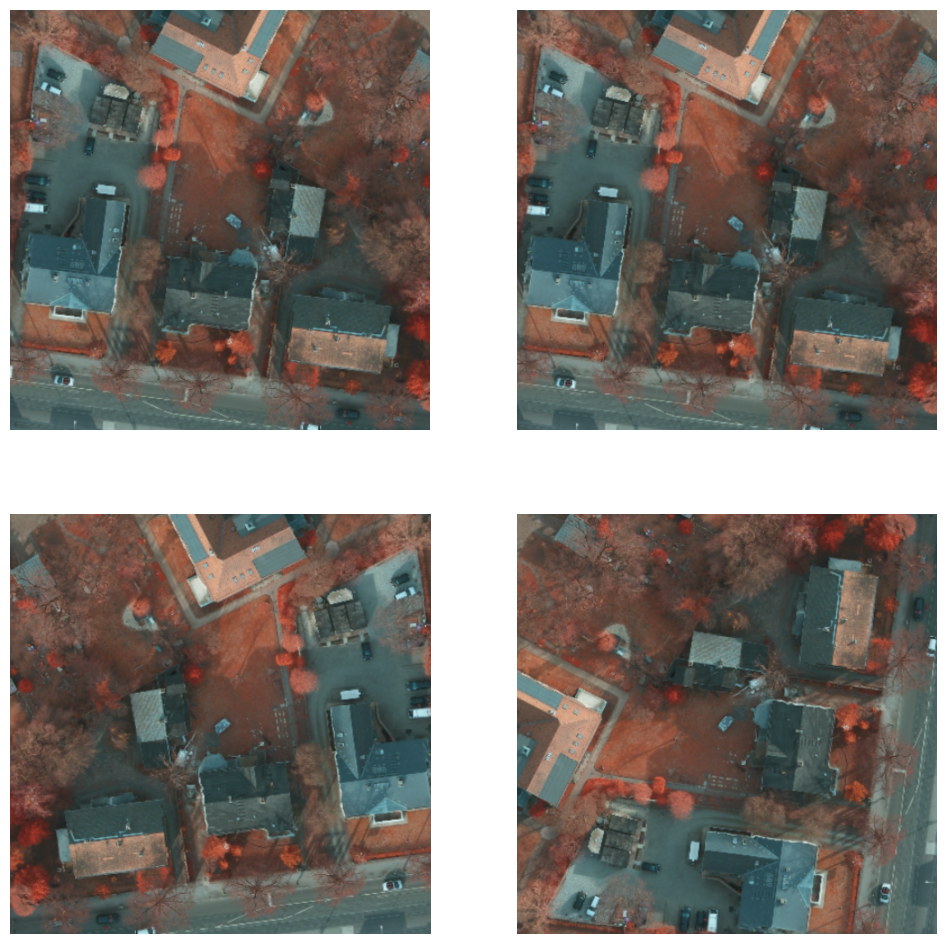

<Figure size 640x480 with 0 Axes>

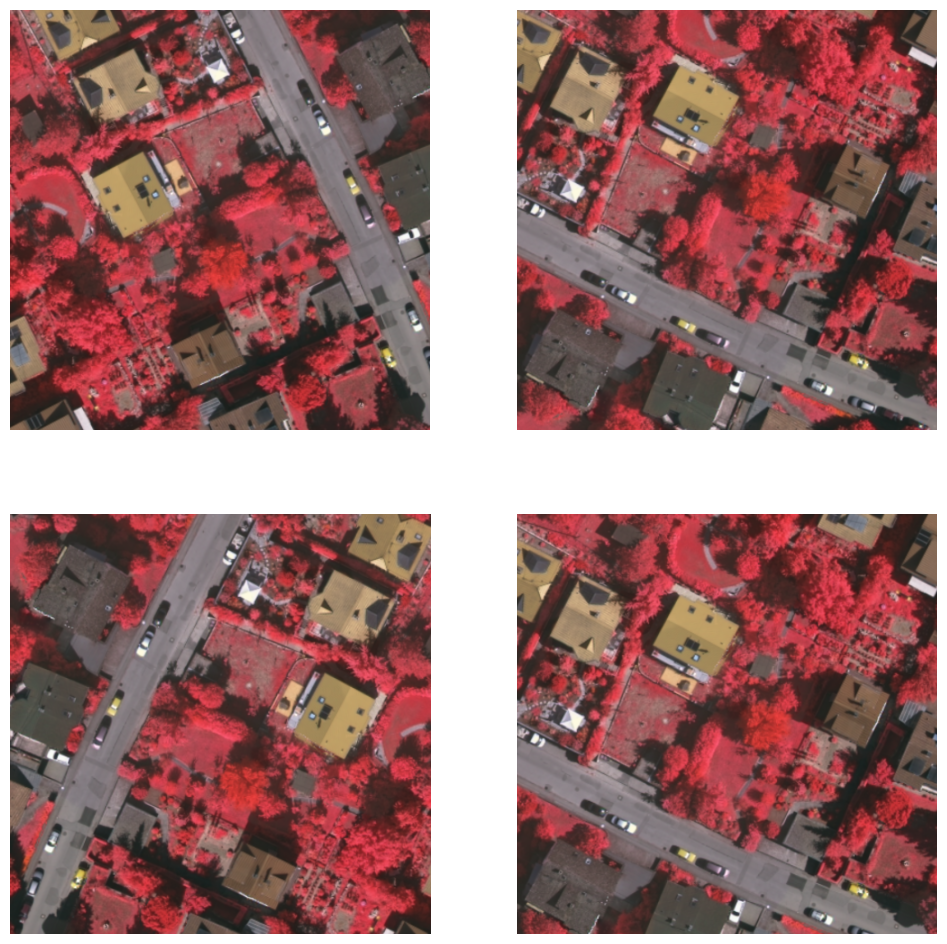

<Figure size 640x480 with 0 Axes>

In [13]:
plt.figure(figsize=(12, 12))
for i in range(4):
  plt.subplot(2, 2, i + 1)
  plt.imshow(random_jitter(sample_pots[0])* 0.5 + 0.5)
  plt.axis('off')
plt.show()
plt.savefig(output_path+'Demo_Potsdam_Jitter.png', bbox_inches='tight')
plt.clf()

plt.figure(figsize=(12, 12))
for i in range(4):
  plt.subplot(2, 2, i + 1)
  plt.imshow(random_jitter(sample_vai[0])* 0.5 + 0.5)
  plt.axis('off')
plt.show()
plt.savefig(output_path+'Demo_Vaihingen_Jitter.png', bbox_inches='tight')
plt.clf()

In [14]:
class InstanceNormalization(tf.keras.layers.Layer):
  """Instance Normalization Layer (https://arxiv.org/abs/1607.08022)."""

  def __init__(self, epsilon=1e-5):
    super(InstanceNormalization, self).__init__()
    self.epsilon = epsilon


  def get_config(self):
      config = super().get_config().copy()
      config.update({
          'epsilon': self.epsilon,
            })
      return config


  def build(self, input_shape):
    self.scale = self.add_weight(
        name='scale',
        shape=input_shape[-1:],
        initializer=tf.random_normal_initializer(1., 0.02),
        trainable=True)

    self.offset = self.add_weight(
        name='offset',
        shape=input_shape[-1:],
        initializer='zeros',
        trainable=True)

  def call(self, x):
    mean, variance = tf.nn.moments(x, axes=[1, 2], keepdims=True)
    inv = tf.math.rsqrt(variance + self.epsilon)
    normalized = (x - mean) * inv
    return self.scale * normalized + self.offset

In [15]:
def downsample(filters, size, norm_type='batchnorm', apply_norm=True):
  """Downsamples an input.
  Conv2D => Batchnorm => LeakyRelu
  Args:
    filters: number of filters
    size: filter size
    norm_type: Normalization type; either 'batchnorm' or 'instancenorm'.
    apply_norm: If True, adds the batchnorm layer
  Returns:
    Downsample Sequential Model
  """
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

  if apply_norm:
    if norm_type.lower() == 'batchnorm':
      result.add(tf.keras.layers.BatchNormalization())
    elif norm_type.lower() == 'instancenorm':
      result.add(InstanceNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result

In [16]:
def upsample(filters, size, norm_type='batchnorm', apply_dropout=False):
  """Upsamples an input.
  Conv2DTranspose => Batchnorm => Dropout => Relu
  Args:
    filters: number of filters
    size: filter size
    norm_type: Normalization type; either 'batchnorm' or 'instancenorm'.
    apply_dropout: If True, adds the dropout layer
  Returns:
    Upsample Sequential Model
  """

  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                      padding='same',
                                      kernel_initializer=initializer,
                                      use_bias=False))

  if norm_type.lower() == 'batchnorm':
    result.add(tf.keras.layers.BatchNormalization())
  elif norm_type.lower() == 'instancenorm':
    result.add(InstanceNormalization())

  if apply_dropout:
    result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result

In [17]:
def unet_generator(output_channels, norm_type='batchnorm'):
  """Modified u-net generator model (https://arxiv.org/abs/1611.07004).
  Args:
    output_channels: Output channels
    norm_type: Type of normalization. Either 'batchnorm' or 'instancenorm'.
  Returns:
    Generator model
  """

  down_stack = [
      downsample(64, 4, norm_type, apply_norm=False),  # (bs, 128, 128, 64)
      downsample(128, 4, norm_type),  # (bs, 64, 64, 128)
      downsample(256, 4, norm_type),  # (bs, 32, 32, 256)
      downsample(512, 4, norm_type),  # (bs, 16, 16, 512)
      downsample(512, 4, norm_type),  # (bs, 8, 8, 512)
      downsample(512, 4, norm_type),  # (bs, 4, 4, 512)
      downsample(512, 4, norm_type),  # (bs, 2, 2, 512)
      downsample(512, 4, norm_type),  # (bs, 1, 1, 512)
  ]

  up_stack = [
      upsample(512, 4, norm_type, apply_dropout=True),  # (bs, 2, 2, 1024)
      upsample(512, 4, norm_type, apply_dropout=True),  # (bs, 4, 4, 1024)
      upsample(512, 4, norm_type, apply_dropout=True),  # (bs, 8, 8, 1024)
      upsample(512, 4, norm_type),  # (bs, 16, 16, 1024)
      upsample(256, 4, norm_type),  # (bs, 32, 32, 512)
      upsample(128, 4, norm_type),  # (bs, 64, 64, 256)
      upsample(64, 4, norm_type),  # (bs, 128, 128, 128)
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(
      output_channels, 4, strides=2,
      padding='same', kernel_initializer=initializer,
      activation='tanh')  # (bs, 256, 256, 3)

  concat = tf.keras.layers.Concatenate()

  inputs = tf.keras.layers.Input(shape=[None, None, 3])
  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = concat([x, skip])

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

In [18]:
def discriminator(norm_type='batchnorm', target=True):
  """PatchGan discriminator model (https://arxiv.org/abs/1611.07004).
  Args:
    norm_type: Type of normalization. Either 'batchnorm' or 'instancenorm'.
    target: Bool, indicating whether target image is an input or not.
  Returns:
    Discriminator model
  """

  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[None, None, 3], name='input_image')
  x = inp

  if target:
    tar = tf.keras.layers.Input(shape=[None, None, 3], name='target_image')
    x = tf.keras.layers.concatenate([inp, tar])  # (bs, 256, 256, channels*2)

  down1 = downsample(64, 4, norm_type, False)(x)  # (bs, 128, 128, 64)
  down2 = downsample(128, 4, norm_type)(down1)  # (bs, 64, 64, 128)
  down3 = downsample(256, 4, norm_type)(down2)  # (bs, 32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3)  # (bs, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(
      512, 4, strides=1, kernel_initializer=initializer,
      use_bias=False)(zero_pad1)  # (bs, 31, 31, 512)

  if norm_type.lower() == 'batchnorm':
    norm1 = tf.keras.layers.BatchNormalization()(conv)
  elif norm_type.lower() == 'instancenorm':
    norm1 = InstanceNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(norm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)  # (bs, 33, 33, 512)

  last = tf.keras.layers.Conv2D(
      1, 4, strides=1,
      kernel_initializer=initializer)(zero_pad2)  # (bs, 30, 30, 1)

  if target:
    return tf.keras.Model(inputs=[inp, tar], outputs=last)
  else:
    return tf.keras.Model(inputs=inp, outputs=last)

In [19]:
generator_g = unet_generator(channels_img, norm_type='instancenorm')
generator_f = unet_generator(channels_img, norm_type='instancenorm')

discriminator_x = discriminator(norm_type='instancenorm', target=False)
discriminator_y = discriminator(norm_type='instancenorm', target=False)

2023-07-19 23:38:03.458047: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:428] Loaded cuDNN version 8401
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


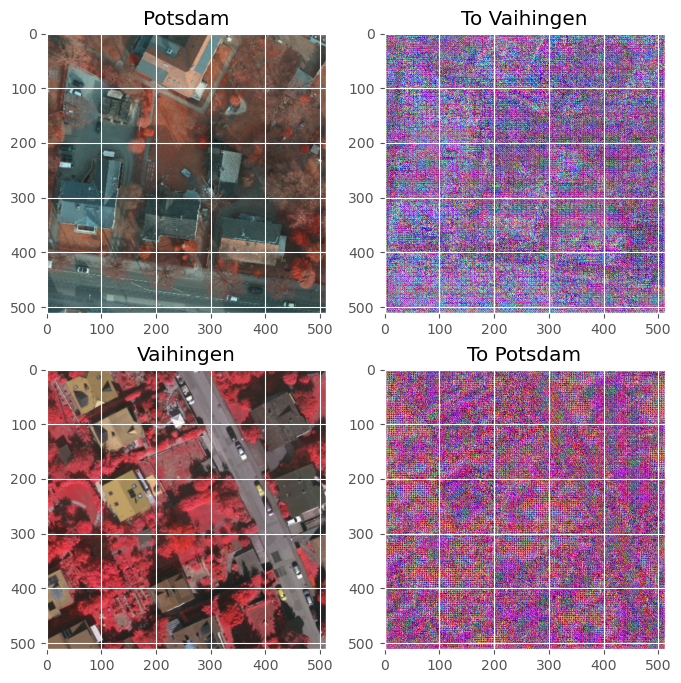

In [20]:
to_vai = generator_g(sample_pots)
to_pots = generator_f(sample_vai)
plt.figure(figsize=(8, 8))
contrast = 8

imgs = [sample_pots, to_vai, sample_vai, to_pots]
title = ['Potsdam', 'To Vaihingen', 'Vaihingen', 'To Potsdam']

for i in range(len(imgs)):
  plt.subplot(2, 2, i+1)
  plt.title(title[i])
  if i % 2 == 0:
    plt.imshow(imgs[i][0]* 0.5 + 0.5)
  else:
    plt.imshow(imgs[i][0] * 0.5 * contrast + 0.5)
plt.savefig(output_path+'Demo_P2V_V2P_Ex.png', bbox_inches='tight')
#plt.clf()

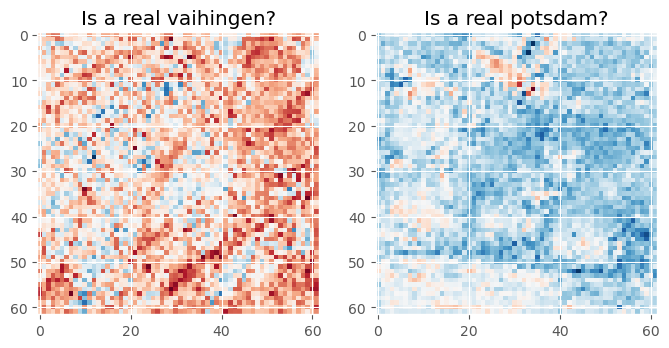

In [21]:
plt.figure(figsize=(8, 8))

plt.subplot(121)
plt.title('Is a real vaihingen?')
plt.imshow(discriminator_y(sample_vai)[0, ..., -1], cmap='RdBu_r')

plt.subplot(122)
plt.title('Is a real potsdam?')
plt.imshow(discriminator_x(sample_pots)[0, ..., -1], cmap='RdBu_r')
plt.savefig(output_path+'Demo_P2V_Disc_Ex.png', bbox_inches='tight')
#plt.clf()

In [22]:
LAMBDA = 10
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real, generated):
  real_loss = loss_obj(tf.ones_like(real), real)
  generated_loss = loss_obj(tf.zeros_like(generated), generated)
  total_disc_loss = real_loss + generated_loss
  return total_disc_loss * 0.5

def generator_loss(generated):
  return loss_obj(tf.ones_like(generated), generated)

def calc_cycle_loss(real_image, cycled_image):
  loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))
  return LAMBDA * loss1

def identity_loss(real_image, same_image):
  loss = tf.reduce_mean(tf.abs(real_image - same_image))
  return LAMBDA * 0.5 * loss

generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [23]:
checkpoint_path = output_path+"checkpoints/checkpoint"

ckpt = tf.train.Checkpoint(generator_g=generator_g,
                           generator_f=generator_f,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           generator_g_optimizer=generator_g_optimizer,
                           generator_f_optimizer=generator_f_optimizer,
                           discriminator_x_optimizer=discriminator_x_optimizer,
                           discriminator_y_optimizer=discriminator_y_optimizer)

In [24]:
def generate_images(model, test_input, num):
    plt.clf()
    prediction = model(test_input)
    plt.figure(figsize=(12, 12))

    display_list = [test_input[0], prediction[0]]
    title = ['Input Image', 'Predicted Image']

    for i in range(2):
        plt.subplot(1, 2, i+1)
        plt.title(title[i])
        # getting the pixel values between [0, 1] to plot it.
        plt.imshow(display_list[i]* 0.5 + 0.5)
        plt.axis('off')
  
    plt.savefig(output_path+'Training_Progress_'+str(num)+'.png', bbox_inches='tight')

In [25]:
@tf.function
def train_step(real_x, real_y):
    # persistent is set to True because the tape is used more than
    # once to calculate the gradients.
    with tf.GradientTape(persistent=True) as tape:
        # Generator G translates X -> Y
        # Generator F translates Y -> X.

        fake_y = generator_g(real_x, training=True)
        cycled_x = generator_f(fake_y, training=True)

        fake_x = generator_f(real_y, training=True)
        cycled_y = generator_g(fake_x, training=True)

        # same_x and same_y are used for identity loss.
        same_x = generator_f(real_x, training=True)
        same_y = generator_g(real_y, training=True)

        disc_real_x = discriminator_x(real_x, training=True)
        disc_real_y = discriminator_y(real_y, training=True)

        disc_fake_x = discriminator_x(fake_x, training=True)
        disc_fake_y = discriminator_y(fake_y, training=True)

        # calculate the loss
        gen_g_loss = generator_loss(disc_fake_y)
        gen_f_loss = generator_loss(disc_fake_x)

        total_cycle_loss = calc_cycle_loss(real_x, cycled_x) + calc_cycle_loss(real_y, cycled_y)
        
        # Calculate total variation loss
        # these has shape of (8,) since it's calculating for each batch in one iteration
        # Remember batch_size was set as 8!
        tv_loss_real_x = tf.image.total_variation(real_x)
        tv_loss_real_y = tf.image.total_variation(real_y)
        tv_loss_fake_x = tf.image.total_variation(fake_x)
        tv_loss_fake_y = tf.image.total_variation(fake_y)
        #so we compute sum over the tensor to make it a scalar, just like other losses.
        tv_loss_real_x_scalar = tf.reduce_sum(tv_loss_real_x)
        tv_loss_real_y_scalar = tf.reduce_sum(tv_loss_real_y)
        tv_loss_fake_x_scalar = tf.reduce_sum(tv_loss_fake_x)
        tv_loss_fake_y_scalar = tf.reduce_sum(tv_loss_fake_x)
        
        # Total generator loss = adversarial loss + cycle loss + total variation loss
        total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y) + tv_loss_fake_y_scalar
        total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x) + tv_loss_fake_x_scalar

        disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
        disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)
        
        
    # Calculate the gradients for generator and discriminator
    generator_g_gradients = tape.gradient(total_gen_g_loss, generator_g.trainable_variables)
    generator_f_gradients = tape.gradient(total_gen_f_loss, generator_f.trainable_variables)

    discriminator_x_gradients = tape.gradient(disc_x_loss, discriminator_x.trainable_variables)
    discriminator_y_gradients = tape.gradient(disc_y_loss, discriminator_y.trainable_variables)

    # Apply the gradients to the optimizer
    generator_g_optimizer.apply_gradients(zip(generator_g_gradients, generator_g.trainable_variables))
    generator_f_optimizer.apply_gradients(zip(generator_f_gradients, generator_f.trainable_variables))
    discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients, discriminator_x.trainable_variables))
    discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients, discriminator_y.trainable_variables))

    return gen_g_loss, gen_f_loss, total_cycle_loss, total_gen_g_loss, total_gen_f_loss, disc_x_loss, disc_y_loss, tv_loss_fake_x_scalar, tv_loss_fake_y_scalar

In [26]:
start_time = time.time()
genGLoss = []
genFLoss = []
cycLoss = []
totgenGLoss = []
totgenFLoss = []
discXLoss = []
discYLoss = []
tv_loss_fake_x = [] #total variation (fake_x = vaihingen in potsdam style)
tv_loss_fake_y = [] #total variation (fake_y = potsdam in vaihingen style)

for epoch in range(EPOCHS):
    start = time.time()
    for image_x, image_y in tf.data.Dataset.zip((train_pots, train_vai)):
        l1, l2, l3, l4, l5, l6, l7, l8, l9 = train_step(image_x, image_y)
      
    # Using a consistent image (sample_potsdam) so that the progress of the model
    # is clearly visible.
    # Read out training results
    genGLoss.append(float(l1))
    genFLoss.append(float(l2))
    cycLoss.append(float(l3))
    totgenGLoss.append(float(l4))
    totgenFLoss.append(float(l5)) 
    discXLoss.append(float(l6))
    discYLoss.append(float(l7)) 
    tv_loss_fake_x.append(float(l8))
    tv_loss_fake_y.append(float(l9))
    
    readout = 'Losses: Gen G(P2V): {}, Gen F(V2P): {}, Cycle: {}, TGen G(P2V): {}, TGen F(V2P): {}, DiscX: {}, DiscY: {}., \n tv_fakeY(Potsdam -> vaihingen): {}., tv_fakeX(Vaihingen -> Potsdam): {}'
    print(readout.format(l1, l2, l3, l4, l5, l6, l7, l8, l9))
    print("\n\n\n")
    print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1, time.time()-start))
    
    """if (epoch%10 == 0):
        generate_images(generator_g, sample_pots, epoch)
    
    if (epoch + 1) % 5 == 0:
        checkpoint_prefix = os.path.join(checkpoint_path, str(epoch+1))
        ckpt.save(file_prefix=checkpoint_prefix)
        print ('Saving checkpoint for epoch {} at {}'.format(epoch+1, checkpoint_prefix))
"""
print('##################################################################')
print("Model training time in seconds: "+str(time.time() - start_time))

2023-07-19 23:38:34.015392: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel/sequential_8/dropout/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer
2023-07-19 23:38:36.272147: I tensorflow/compiler/xla/service/service.cc:173] XLA service 0x55b449313a10 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2023-07-19 23:38:36.272186: I tensorflow/compiler/xla/service/service.cc:181]   StreamExecutor device (0): Tesla V100S-PCIE-32GB, Compute Capability 7.0
2023-07-19 23:38:36.277129: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2023-07-19 23:38:36.371923: I tensorflow/compiler/jit/xla_compilation_cache.cc:477] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.
2023-07-19 23:39

Losses: Gen G(P2V): 0.9667062163352966, Gen F(V2P): 1.6520932912826538, Cycle: 4.416346549987793, TGen G(P2V): 308171.8125, TGen F(V2P): 308173.3125, DiscX: 0.30976998805999756, DiscY: 0.7447417974472046., 
 tv_fakeY(Potsdam -> vaihingen): 308165.625., tv_fakeX(Vaihingen -> Potsdam): 308165.625




Time taken for epoch 1 is 71.02620816230774 sec

Losses: Gen G(P2V): 0.736340343952179, Gen F(V2P): 2.5212669372558594, Cycle: 4.84263277053833, TGen G(P2V): 176714.375, TGen F(V2P): 176717.546875, DiscX: 0.10629144310951233, DiscY: 0.6741840839385986., 
 tv_fakeY(Potsdam -> vaihingen): 176708.234375., tv_fakeX(Vaihingen -> Potsdam): 176708.234375




Time taken for epoch 2 is 35.767170906066895 sec

Losses: Gen G(P2V): 0.7271945476531982, Gen F(V2P): 3.2268424034118652, Cycle: 4.6989946365356445, TGen G(P2V): 133900.5, TGen F(V2P): 133904.328125, DiscX: 0.05858910083770752, DiscY: 0.7016410827636719., 
 tv_fakeY(Potsdam -> vaihingen): 133894.53125., tv_fakeX(Vaihingen -> Potsdam): 133894.53

Losses: Gen G(P2V): 0.723097026348114, Gen F(V2P): 6.760187149047852, Cycle: 4.473669528961182, TGen G(P2V): 31683.84375, TGen F(V2P): 31691.466796875, DiscX: 0.0015939914155751467, DiscY: 0.7038068771362305., 
 tv_fakeY(Potsdam -> vaihingen): 31678.4375., tv_fakeX(Vaihingen -> Potsdam): 31678.4375




Time taken for epoch 24 is 36.04940962791443 sec

Losses: Gen G(P2V): 0.6911593079566956, Gen F(V2P): 7.02302885055542, Cycle: 4.087021827697754, TGen G(P2V): 32674.638671875, TGen F(V2P): 32682.373046875, DiscX: 0.0016196378273889422, DiscY: 0.6830708980560303., 
 tv_fakeY(Potsdam -> vaihingen): 32669.6484375., tv_fakeX(Vaihingen -> Potsdam): 32669.6484375




Time taken for epoch 25 is 36.01152682304382 sec

Losses: Gen G(P2V): 0.6428513526916504, Gen F(V2P): 7.0460896492004395, Cycle: 4.659938812255859, TGen G(P2V): 32704.150390625, TGen F(V2P): 32712.16796875, DiscX: 0.0014367050025612116, DiscY: 0.7056586742401123., 
 tv_fakeY(Potsdam -> vaihingen): 32698.638671875., tv_fakeX(Vaihin

Losses: Gen G(P2V): 0.698129415512085, Gen F(V2P): 8.214177131652832, Cycle: 3.890486240386963, TGen G(P2V): 18408.984375, TGen F(V2P): 18417.8046875, DiscX: 0.0006604988593608141, DiscY: 0.6921623945236206., 
 tv_fakeY(Potsdam -> vaihingen): 18404.23046875., tv_fakeX(Vaihingen -> Potsdam): 18404.23046875




Time taken for epoch 47 is 36.08892583847046 sec

Losses: Gen G(P2V): 0.7535887956619263, Gen F(V2P): 7.929610252380371, Cycle: 4.2456536293029785, TGen G(P2V): 22344.982421875, TGen F(V2P): 22353.541015625, DiscX: 0.00070896529359743, DiscY: 0.687147855758667., 
 tv_fakeY(Potsdam -> vaihingen): 22339.828125., tv_fakeX(Vaihingen -> Potsdam): 22339.828125




Time taken for epoch 48 is 36.027841567993164 sec

Losses: Gen G(P2V): 0.6986428499221802, Gen F(V2P): 8.099968910217285, Cycle: 3.9045591354370117, TGen G(P2V): 19989.330078125, TGen F(V2P): 19998.05078125, DiscX: 0.00038108968874439597, DiscY: 0.68629390001297., 
 tv_fakeY(Potsdam -> vaihingen): 19984.578125., tv_fakeX(Vaihi

Losses: Gen G(P2V): 0.7028093338012695, Gen F(V2P): 8.464251518249512, Cycle: 4.285195827484131, TGen G(P2V): 12828.1591796875, TGen F(V2P): 12837.353515625, DiscX: 0.00020649033831432462, DiscY: 0.6972472667694092., 
 tv_fakeY(Potsdam -> vaihingen): 12823.02734375., tv_fakeX(Vaihingen -> Potsdam): 12823.02734375




Time taken for epoch 70 is 36.088600158691406 sec

Losses: Gen G(P2V): 0.7356287240982056, Gen F(V2P): 8.833556175231934, Cycle: 4.372010231018066, TGen G(P2V): 12716.1171875, TGen F(V2P): 12725.6220703125, DiscX: 0.00020713070989586413, DiscY: 0.680922269821167., 
 tv_fakeY(Potsdam -> vaihingen): 12710.875., tv_fakeX(Vaihingen -> Potsdam): 12710.875




Time taken for epoch 71 is 36.04513072967529 sec

Losses: Gen G(P2V): 0.7233267426490784, Gen F(V2P): 8.578638076782227, Cycle: 3.8299849033355713, TGen G(P2V): 14311.7412109375, TGen F(V2P): 14320.828125, DiscX: 0.00023641521693207324, DiscY: 0.6874502301216125., 
 tv_fakeY(Potsdam -> vaihingen): 14307.0537109375., tv_fak

Losses: Gen G(P2V): 0.6801217198371887, Gen F(V2P): 9.146710395812988, Cycle: 4.029796600341797, TGen G(P2V): 10132.3310546875, TGen F(V2P): 10142.22265625, DiscX: 0.00013859523460268974, DiscY: 0.6925107836723328., 
 tv_fakeY(Potsdam -> vaihingen): 10127.51171875., tv_fakeX(Vaihingen -> Potsdam): 10127.51171875




Time taken for epoch 93 is 36.0312602519989 sec

Losses: Gen G(P2V): 0.7170369625091553, Gen F(V2P): 9.096752166748047, Cycle: 3.817089080810547, TGen G(P2V): 10778.8994140625, TGen F(V2P): 10788.61328125, DiscX: 0.00015446325414814055, DiscY: 0.6843494176864624., 
 tv_fakeY(Potsdam -> vaihingen): 10774.255859375., tv_fakeX(Vaihingen -> Potsdam): 10774.255859375




Time taken for epoch 94 is 36.103271484375 sec

Losses: Gen G(P2V): 0.6931116580963135, Gen F(V2P): 9.089118003845215, Cycle: 4.285529136657715, TGen G(P2V): 9735.083984375, TGen F(V2P): 9744.8935546875, DiscX: 0.0001656875538174063, DiscY: 0.6819027662277222., 
 tv_fakeY(Potsdam -> vaihingen): 9729.9765625., tv

Losses: Gen G(P2V): 0.7532642483711243, Gen F(V2P): 7.53143310546875, Cycle: 4.05564546585083, TGen G(P2V): 6415.2421875, TGen F(V2P): 6423.40625, DiscX: 0.0006225993274711072, DiscY: 0.671184241771698., 
 tv_fakeY(Potsdam -> vaihingen): 6410.31591796875., tv_fakeX(Vaihingen -> Potsdam): 6410.31591796875




Time taken for epoch 116 is 36.063215017318726 sec

Losses: Gen G(P2V): 0.6729504466056824, Gen F(V2P): 7.458702087402344, Cycle: 4.278422832489014, TGen G(P2V): 6976.22607421875, TGen F(V2P): 6984.4970703125, DiscX: 0.0005159324500709772, DiscY: 0.7210431694984436., 
 tv_fakeY(Potsdam -> vaihingen): 6971.1572265625., tv_fakeX(Vaihingen -> Potsdam): 6971.1572265625




Time taken for epoch 117 is 36.089842796325684 sec

Losses: Gen G(P2V): 0.6888381242752075, Gen F(V2P): 7.5809712409973145, Cycle: 4.027989387512207, TGen G(P2V): 6724.87939453125, TGen F(V2P): 6733.138671875, DiscX: 0.0006042046006768942, DiscY: 0.6781316995620728., 
 tv_fakeY(Potsdam -> vaihingen): 6720.033203125.,

Losses: Gen G(P2V): 0.7196199893951416, Gen F(V2P): 8.16431713104248, Cycle: 4.611443996429443, TGen G(P2V): 6394.60498046875, TGen F(V2P): 6403.62451171875, DiscX: 0.00027282198425382376, DiscY: 0.6811195015907288., 
 tv_fakeY(Potsdam -> vaihingen): 6389.15966796875., tv_fakeX(Vaihingen -> Potsdam): 6389.15966796875




Time taken for epoch 139 is 36.40502047538757 sec

Losses: Gen G(P2V): 0.6884219646453857, Gen F(V2P): 8.310967445373535, Cycle: 4.363903999328613, TGen G(P2V): 5607.2041015625, TGen F(V2P): 5616.37255859375, DiscX: 0.00022211563191376626, DiscY: 0.6848908066749573., 
 tv_fakeY(Potsdam -> vaihingen): 5602.04345703125., tv_fakeX(Vaihingen -> Potsdam): 5602.04345703125




Time taken for epoch 140 is 36.370930671691895 sec

Losses: Gen G(P2V): 0.7015188932418823, Gen F(V2P): 8.41413402557373, Cycle: 4.408457279205322, TGen G(P2V): 4911.3564453125, TGen F(V2P): 4920.60888671875, DiscX: 0.0002271304401801899, DiscY: 0.7216843962669373., 
 tv_fakeY(Potsdam -> vaihingen): 49

Losses: Gen G(P2V): 0.6879689693450928, Gen F(V2P): 9.256821632385254, Cycle: 4.736629486083984, TGen G(P2V): 3328.830078125, TGen F(V2P): 3339.103759765625, DiscX: 0.00014157270197756588, DiscY: 0.6908085346221924., 
 tv_fakeY(Potsdam -> vaihingen): 3323.30224609375., tv_fakeX(Vaihingen -> Potsdam): 3323.30224609375




Time taken for epoch 161 is 36.307729721069336 sec

Losses: Gen G(P2V): 0.6896315813064575, Gen F(V2P): 9.163541793823242, Cycle: 4.9782609939575195, TGen G(P2V): 3847.05908203125, TGen F(V2P): 3857.307373046875, DiscX: 0.0001433520228601992, DiscY: 0.6683158874511719., 
 tv_fakeY(Potsdam -> vaihingen): 3841.2822265625., tv_fakeX(Vaihingen -> Potsdam): 3841.2822265625




Time taken for epoch 162 is 36.29022192955017 sec

Losses: Gen G(P2V): 0.7065566182136536, Gen F(V2P): 9.210966110229492, Cycle: 4.894936561584473, TGen G(P2V): 3041.58056640625, TGen F(V2P): 3051.85498046875, DiscX: 0.00011173656093887985, DiscY: 0.684873104095459., 
 tv_fakeY(Potsdam -> vaihingen): 

Losses: Gen G(P2V): 0.7516399025917053, Gen F(V2P): 9.559816360473633, Cycle: 5.254621505737305, TGen G(P2V): 1836.1466064453125, TGen F(V2P): 1846.8956298828125, DiscX: 7.860222831368446e-05, DiscY: 0.6832420825958252., 
 tv_fakeY(Potsdam -> vaihingen): 1830.032470703125., tv_fakeX(Vaihingen -> Potsdam): 1830.032470703125




Time taken for epoch 183 is 36.31015491485596 sec

Losses: Gen G(P2V): 0.7460505962371826, Gen F(V2P): 9.640734672546387, Cycle: 4.899439811706543, TGen G(P2V): 1868.8564453125, TGen F(V2P): 1879.5196533203125, DiscX: 6.0434191254898906e-05, DiscY: 0.7187339067459106., 
 tv_fakeY(Potsdam -> vaihingen): 1863.089599609375., tv_fakeX(Vaihingen -> Potsdam): 1863.089599609375




Time taken for epoch 184 is 36.29254508018494 sec

Losses: Gen G(P2V): 0.7571792006492615, Gen F(V2P): 9.493362426757812, Cycle: 5.112113952636719, TGen G(P2V): 2418.073486328125, TGen F(V2P): 2428.642822265625, DiscX: 7.510931754950434e-05, DiscY: 0.685576319694519., 
 tv_fakeY(Potsdam -> va

Losses: Gen G(P2V): 0.7309344410896301, Gen F(V2P): 10.009934425354004, Cycle: 5.170346736907959, TGen G(P2V): 1282.1251220703125, TGen F(V2P): 1293.3673095703125, DiscX: 4.2859421228058636e-05, DiscY: 0.6717096567153931., 
 tv_fakeY(Potsdam -> vaihingen): 1276.09912109375., tv_fakeX(Vaihingen -> Potsdam): 1276.09912109375




Time taken for epoch 205 is 36.3097620010376 sec

Losses: Gen G(P2V): 0.6879456043243408, Gen F(V2P): 9.946758270263672, Cycle: 5.386537075042725, TGen G(P2V): 1303.2630615234375, TGen F(V2P): 1314.6182861328125, DiscX: 4.3591899157036096e-05, DiscY: 0.6985126733779907., 
 tv_fakeY(Potsdam -> vaihingen): 1297.08837890625., tv_fakeX(Vaihingen -> Potsdam): 1297.08837890625




Time taken for epoch 206 is 36.30471348762512 sec

Losses: Gen G(P2V): 0.7311050891876221, Gen F(V2P): 9.902994155883789, Cycle: 5.573451995849609, TGen G(P2V): 1420.574951171875, TGen F(V2P): 1431.8812255859375, DiscX: 4.545909905573353e-05, DiscY: 0.688469648361206., 
 tv_fakeY(Potsdam -> v

Losses: Gen G(P2V): 0.7268550395965576, Gen F(V2P): 10.214652061462402, Cycle: 5.838621139526367, TGen G(P2V): 993.55078125, TGen F(V2P): 1005.290771484375, DiscX: 3.588096660678275e-05, DiscY: 0.6638737916946411., 
 tv_fakeY(Potsdam -> vaihingen): 986.8782958984375., tv_fakeX(Vaihingen -> Potsdam): 986.8782958984375




Time taken for epoch 227 is 36.30136513710022 sec

Losses: Gen G(P2V): 0.8130504488945007, Gen F(V2P): 9.900444030761719, Cycle: 6.047999382019043, TGen G(P2V): 1653.922119140625, TGen F(V2P): 1665.37890625, DiscX: 3.9381156966555864e-05, DiscY: 0.7321697473526001., 
 tv_fakeY(Potsdam -> vaihingen): 1646.9578857421875., tv_fakeX(Vaihingen -> Potsdam): 1646.9578857421875




Time taken for epoch 228 is 36.34179067611694 sec

Losses: Gen G(P2V): 0.6998846530914307, Gen F(V2P): 10.146171569824219, Cycle: 5.736116886138916, TGen G(P2V): 1586.07958984375, TGen F(V2P): 1597.7523193359375, DiscX: 4.358472506282851e-05, DiscY: 0.7059788703918457., 
 tv_fakeY(Potsdam -> vaihing

Losses: Gen G(P2V): 0.792158842086792, Gen F(V2P): 7.844163417816162, Cycle: 6.7921833992004395, TGen G(P2V): 1128.0211181640625, TGen F(V2P): 1137.6278076171875, DiscX: 0.0003796763776335865, DiscY: 0.6661108732223511., 
 tv_fakeY(Potsdam -> vaihingen): 1120.302001953125., tv_fakeX(Vaihingen -> Potsdam): 1120.302001953125




Time taken for epoch 249 is 36.29302501678467 sec

Losses: Gen G(P2V): 0.7813039422035217, Gen F(V2P): 7.924984455108643, Cycle: 6.055995464324951, TGen G(P2V): 1612.6585693359375, TGen F(V2P): 1622.062744140625, DiscX: 0.0004523310635704547, DiscY: 0.6131269335746765., 
 tv_fakeY(Potsdam -> vaihingen): 1605.704833984375., tv_fakeX(Vaihingen -> Potsdam): 1605.704833984375




Time taken for epoch 250 is 36.28701210021973 sec

Losses: Gen G(P2V): 0.8065299987792969, Gen F(V2P): 7.819375514984131, Cycle: 6.335482597351074, TGen G(P2V): 1344.309814453125, TGen F(V2P): 1353.70361328125, DiscX: 0.0003802328137680888, DiscY: 0.6294677257537842., 
 tv_fakeY(Potsdam -> v

Losses: Gen G(P2V): 0.7700280547142029, Gen F(V2P): 8.723353385925293, Cycle: 6.58928108215332, TGen G(P2V): 825.8896484375, TGen F(V2P): 836.40234375, DiscX: 0.00015719342627562582, DiscY: 0.6435437202453613., 
 tv_fakeY(Potsdam -> vaihingen): 818.416748046875., tv_fakeX(Vaihingen -> Potsdam): 818.416748046875




Time taken for epoch 271 is 36.3306565284729 sec

Losses: Gen G(P2V): 0.8437072038650513, Gen F(V2P): 8.719890594482422, Cycle: 7.042510032653809, TGen G(P2V): 869.491455078125, TGen F(V2P): 880.135009765625, DiscX: 0.00015221023932099342, DiscY: 0.6490929126739502., 
 tv_fakeY(Potsdam -> vaihingen): 861.4906005859375., tv_fakeX(Vaihingen -> Potsdam): 861.4906005859375




Time taken for epoch 272 is 36.28407835960388 sec

Losses: Gen G(P2V): 0.7654324173927307, Gen F(V2P): 8.717829704284668, Cycle: 7.13815450668335, TGen G(P2V): 1149.3238525390625, TGen F(V2P): 1160.0523681640625, DiscX: 0.00014893968182150275, DiscY: 0.6609396934509277., 
 tv_fakeY(Potsdam -> vaihingen): 1

Losses: Gen G(P2V): 0.6611182689666748, Gen F(V2P): 9.199373245239258, Cycle: 6.488770484924316, TGen G(P2V): 661.474853515625, TGen F(V2P): 672.5969848632812, DiscX: 9.042950114235282e-05, DiscY: 0.6918189525604248., 
 tv_fakeY(Potsdam -> vaihingen): 654.2158813476562., tv_fakeX(Vaihingen -> Potsdam): 654.2158813476562




Time taken for epoch 293 is 36.34816527366638 sec

Losses: Gen G(P2V): 0.7161142230033875, Gen F(V2P): 9.230428695678711, Cycle: 6.939749240875244, TGen G(P2V): 865.2847900390625, TGen F(V2P): 876.59326171875, DiscX: 9.413197403773665e-05, DiscY: 0.6870090961456299., 
 tv_fakeY(Potsdam -> vaihingen): 857.517333984375., tv_fakeX(Vaihingen -> Potsdam): 857.517333984375




Time taken for epoch 294 is 36.32637000083923 sec

Losses: Gen G(P2V): 0.8058708310127258, Gen F(V2P): 9.235710144042969, Cycle: 6.932788848876953, TGen G(P2V): 674.0081787109375, TGen F(V2P): 685.2572021484375, DiscX: 9.5798859547358e-05, DiscY: 0.662239670753479., 
 tv_fakeY(Potsdam -> vaihingen):

Losses: Gen G(P2V): 0.7378008365631104, Gen F(V2P): 9.585222244262695, Cycle: 8.42678165435791, TGen G(P2V): 1405.6343994140625, TGen F(V2P): 1417.304931640625, DiscX: 6.431638030335307e-05, DiscY: 0.7390966415405273., 
 tv_fakeY(Potsdam -> vaihingen): 1396.346923828125., tv_fakeX(Vaihingen -> Potsdam): 1396.346923828125




Time taken for epoch 315 is 36.30599927902222 sec

Losses: Gen G(P2V): 0.6833902597427368, Gen F(V2P): 9.644124984741211, Cycle: 7.131463527679443, TGen G(P2V): 916.1030883789062, TGen F(V2P): 927.9555053710938, DiscX: 6.0858546930830926e-05, DiscY: 0.7208777666091919., 
 tv_fakeY(Potsdam -> vaihingen): 908.1622924804688., tv_fakeX(Vaihingen -> Potsdam): 908.1622924804688




Time taken for epoch 316 is 36.29790472984314 sec

Losses: Gen G(P2V): 0.7251832485198975, Gen F(V2P): 9.654945373535156, Cycle: 7.32409143447876, TGen G(P2V): 800.2164306640625, TGen F(V2P): 812.1304931640625, DiscX: 5.634087574435398e-05, DiscY: 0.6497436761856079., 
 tv_fakeY(Potsdam -> vai

Losses: Gen G(P2V): 0.6688137650489807, Gen F(V2P): 9.983431816101074, Cycle: 8.298316955566406, TGen G(P2V): 491.9601135253906, TGen F(V2P): 504.4120788574219, DiscX: 3.814293449977413e-05, DiscY: 0.6338192224502563., 
 tv_fakeY(Potsdam -> vaihingen): 482.88067626953125., tv_fakeX(Vaihingen -> Potsdam): 482.88067626953125




Time taken for epoch 337 is 36.27767205238342 sec

Losses: Gen G(P2V): 0.7352517247200012, Gen F(V2P): 9.946125030517578, Cycle: 7.8015217781066895, TGen G(P2V): 595.5980224609375, TGen F(V2P): 608.0614013671875, DiscX: 4.392509436002001e-05, DiscY: 0.6424664258956909., 
 tv_fakeY(Potsdam -> vaihingen): 586.9532470703125., tv_fakeX(Vaihingen -> Potsdam): 586.9532470703125




Time taken for epoch 338 is 36.36419153213501 sec

Losses: Gen G(P2V): 0.6661163568496704, Gen F(V2P): 9.980109214782715, Cycle: 7.340126991271973, TGen G(P2V): 435.52154541015625, TGen F(V2P): 447.77996826171875, DiscX: 3.76106399926357e-05, DiscY: 0.6746028065681458., 
 tv_fakeY(Potsdam ->

Losses: Gen G(P2V): 1.1798059940338135, Gen F(V2P): 10.279463768005371, Cycle: 7.786053657531738, TGen G(P2V): 375.51123046875, TGen F(V2P): 387.80645751953125, DiscX: 2.9752460250165313e-05, DiscY: 0.5690364241600037., 
 tv_fakeY(Potsdam -> vaihingen): 366.42608642578125., tv_fakeX(Vaihingen -> Potsdam): 366.42608642578125




Time taken for epoch 359 is 36.3337185382843 sec

Losses: Gen G(P2V): 0.8502097129821777, Gen F(V2P): 10.286478996276855, Cycle: 7.218335151672363, TGen G(P2V): 520.321044921875, TGen F(V2P): 532.7238159179688, DiscX: 3.1430616218131036e-05, DiscY: 0.6507456302642822., 
 tv_fakeY(Potsdam -> vaihingen): 512.1363525390625., tv_fakeX(Vaihingen -> Potsdam): 512.1363525390625




Time taken for epoch 360 is 36.28516221046448 sec

Losses: Gen G(P2V): 0.6509640216827393, Gen F(V2P): 10.32268238067627, Cycle: 8.298630714416504, TGen G(P2V): 573.409423828125, TGen F(V2P): 586.3955078125, DiscX: 2.6991645427187905e-05, DiscY: 0.6738713383674622., 
 tv_fakeY(Potsdam -> vai

Losses: Gen G(P2V): 1.2016494274139404, Gen F(V2P): 10.584640502929688, Cycle: 8.608802795410156, TGen G(P2V): 334.2973327636719, TGen F(V2P): 346.9732360839844, DiscX: 2.586482878541574e-05, DiscY: 0.5561953186988831., 
 tv_fakeY(Potsdam -> vaihingen): 324.364501953125., tv_fakeX(Vaihingen -> Potsdam): 324.364501953125




Time taken for epoch 381 is 36.271125078201294 sec

Losses: Gen G(P2V): 0.8045017719268799, Gen F(V2P): 10.607721328735352, Cycle: 7.869909286499023, TGen G(P2V): 409.48980712890625, TGen F(V2P): 422.50067138671875, DiscX: 2.098336881317664e-05, DiscY: 0.6304236054420471., 
 tv_fakeY(Potsdam -> vaihingen): 400.7012939453125., tv_fakeX(Vaihingen -> Potsdam): 400.7012939453125




Time taken for epoch 382 is 36.3175995349884 sec

Losses: Gen G(P2V): 0.9777227640151978, Gen F(V2P): 10.629653930664062, Cycle: 8.450942993164062, TGen G(P2V): 312.04620361328125, TGen F(V2P): 324.9137268066406, DiscX: 1.9711624190676957e-05, DiscY: 0.5664457082748413., 
 tv_fakeY(Potsdam -

Losses: Gen G(P2V): 0.9096146821975708, Gen F(V2P): 10.885116577148438, Cycle: 8.701071739196777, TGen G(P2V): 388.25689697265625, TGen F(V2P): 401.6310119628906, DiscX: 1.5285431800293736e-05, DiscY: 0.600660502910614., 
 tv_fakeY(Potsdam -> vaihingen): 378.51190185546875., tv_fakeX(Vaihingen -> Potsdam): 378.51190185546875




Time taken for epoch 403 is 36.2831449508667 sec

Losses: Gen G(P2V): 1.1711641550064087, Gen F(V2P): 10.87139892578125, Cycle: 8.105719566345215, TGen G(P2V): 259.3001403808594, TGen F(V2P): 272.14825439453125, DiscX: 1.400907876814017e-05, DiscY: 0.5300040245056152., 
 tv_fakeY(Potsdam -> vaihingen): 249.9036865234375., tv_fakeX(Vaihingen -> Potsdam): 249.9036865234375




Time taken for epoch 404 is 36.22746467590332 sec

Losses: Gen G(P2V): 0.8269656300544739, Gen F(V2P): 10.900304794311523, Cycle: 8.235394477844238, TGen G(P2V): 264.92535400390625, TGen F(V2P): 278.39093017578125, DiscX: 1.5643428923795e-05, DiscY: 0.6152576208114624., 
 tv_fakeY(Potsdam -

Losses: Gen G(P2V): 1.0585899353027344, Gen F(V2P): 11.166326522827148, Cycle: 7.943591117858887, TGen G(P2V): 242.71060180664062, TGen F(V2P): 256.0572814941406, DiscX: 1.1861567145388108e-05, DiscY: 0.5757818818092346., 
 tv_fakeY(Potsdam -> vaihingen): 233.59542846679688., tv_fakeX(Vaihingen -> Potsdam): 233.59542846679688




Time taken for epoch 425 is 36.27143120765686 sec

Losses: Gen G(P2V): 0.8233100175857544, Gen F(V2P): 11.174602508544922, Cycle: 8.17691707611084, TGen G(P2V): 238.2268829345703, TGen F(V2P): 252.02288818359375, DiscX: 1.2736483768094331e-05, DiscY: 0.6977061033248901., 
 tv_fakeY(Potsdam -> vaihingen): 229.1023712158203., tv_fakeX(Vaihingen -> Potsdam): 229.1023712158203




Time taken for epoch 426 is 36.35160255432129 sec

Losses: Gen G(P2V): 1.283401370048523, Gen F(V2P): 11.194005966186523, Cycle: 8.63486099243164, TGen G(P2V): 269.94451904296875, TGen F(V2P): 283.3504638671875, DiscX: 1.2036132829962298e-05, DiscY: 0.5932695865631104., 
 tv_fakeY(Potsda

Losses: Gen G(P2V): 0.8530906438827515, Gen F(V2P): 11.47982406616211, Cycle: 8.342977523803711, TGen G(P2V): 183.9357452392578, TGen F(V2P): 197.92221069335938, DiscX: 8.17062482383335e-06, DiscY: 0.5804723501205444., 
 tv_fakeY(Potsdam -> vaihingen): 174.62039184570312., tv_fakeX(Vaihingen -> Potsdam): 174.62039184570312




Time taken for epoch 449 is 36.28493094444275 sec

Losses: Gen G(P2V): 0.9382237195968628, Gen F(V2P): 11.486671447753906, Cycle: 8.492876052856445, TGen G(P2V): 225.8452911376953, TGen F(V2P): 239.99459838867188, DiscX: 8.954377335612662e-06, DiscY: 0.7564329504966736., 
 tv_fakeY(Potsdam -> vaihingen): 216.29104614257812., tv_fakeX(Vaihingen -> Potsdam): 216.29104614257812




Time taken for epoch 450 is 36.233165979385376 sec

Losses: Gen G(P2V): 1.1846970319747925, Gen F(V2P): 11.501851081848145, Cycle: 8.901930809020996, TGen G(P2V): 194.3216552734375, TGen F(V2P): 208.26272583007812, DiscX: 9.437005246581975e-06, DiscY: 0.5121020674705505., 
 tv_fakeY(Potsd

Losses: Gen G(P2V): 0.9220389127731323, Gen F(V2P): 11.747448921203613, Cycle: 8.715171813964844, TGen G(P2V): 346.350341796875, TGen F(V2P): 360.8138732910156, DiscX: 6.239905360416742e-06, DiscY: 0.5442981719970703., 
 tv_fakeY(Potsdam -> vaihingen): 336.59014892578125., tv_fakeX(Vaihingen -> Potsdam): 336.59014892578125




Time taken for epoch 471 is 36.306872606277466 sec

Losses: Gen G(P2V): 0.7842525839805603, Gen F(V2P): 11.756531715393066, Cycle: 8.767178535461426, TGen G(P2V): 263.6436767578125, TGen F(V2P): 278.2889404296875, DiscX: 6.145824954728596e-06, DiscY: 0.7618324756622314., 
 tv_fakeY(Potsdam -> vaihingen): 253.9379425048828., tv_fakeX(Vaihingen -> Potsdam): 253.9379425048828




Time taken for epoch 472 is 36.27001237869263 sec

Losses: Gen G(P2V): 1.2359840869903564, Gen F(V2P): 11.772459030151367, Cycle: 8.856447219848633, TGen G(P2V): 184.5259552001953, TGen F(V2P): 198.73228454589844, DiscX: 5.901833901589271e-06, DiscY: 0.5630751848220825., 
 tv_fakeY(Potsdam 

Losses: Gen G(P2V): 0.8066920638084412, Gen F(V2P): 12.022271156311035, Cycle: 8.653682708740234, TGen G(P2V): 348.3472595214844, TGen F(V2P): 363.1964416503906, DiscX: 4.75747583550401e-06, DiscY: 0.5506024956703186., 
 tv_fakeY(Potsdam -> vaihingen): 338.7606201171875., tv_fakeX(Vaihingen -> Potsdam): 338.7606201171875




Time taken for epoch 493 is 36.27026677131653 sec

Losses: Gen G(P2V): 1.2142082452774048, Gen F(V2P): 12.04329776763916, Cycle: 8.948629379272461, TGen G(P2V): 221.9351806640625, TGen F(V2P): 236.44927978515625, DiscX: 4.994806658942252e-06, DiscY: 0.6539903879165649., 
 tv_fakeY(Potsdam -> vaihingen): 211.65711975097656., tv_fakeX(Vaihingen -> Potsdam): 211.65711975097656




Time taken for epoch 494 is 36.27786374092102 sec

Losses: Gen G(P2V): 0.8617067933082581, Gen F(V2P): 12.05125904083252, Cycle: 8.709305763244629, TGen G(P2V): 229.26356506347656, TGen F(V2P): 244.1126708984375, DiscX: 5.1828001232934184e-06, DiscY: 0.5119920969009399., 
 tv_fakeY(Potsdam -

In [27]:
# Save the final weights in a separate file
check_gen_g_path = output_path+"checkpoints/GenG/"
check_gen_f_path = output_path+"checkpoints/GenF/"
check_disc_x_path = output_path+"checkpoints/DisX/"
check_disc_y_path = output_path+"checkpoints/DisY/"

generator_g.save_weights(check_gen_g_path)
generator_f.save_weights(check_gen_f_path)
discriminator_x.save_weights(check_disc_x_path)
discriminator_y.save_weights(check_disc_y_path)


# Calling `save('my_model.h5')` creates a h5 file `my_model.h5`.
generator_g.save(output_path+"Generator_G_P2V_"+str(model_size))
generator_f.save(output_path+"Generator_F_V2P_"+str(model_size))
discriminator_x.save(output_path+"Discriminator_X_P_"+str(model_size))
discriminator_y.save(output_path+"Discriminator_Y_V_"+str(model_size))

INFO:tensorflow:Assets written to: CGAN_P2V/with TV/Generator_G_P2V_64/assets


INFO:tensorflow:Assets written to: CGAN_P2V/with TV/Generator_G_P2V_64/assets


INFO:tensorflow:Assets written to: CGAN_P2V/with TV/Generator_F_V2P_64/assets


INFO:tensorflow:Assets written to: CGAN_P2V/with TV/Generator_F_V2P_64/assets


INFO:tensorflow:Assets written to: CGAN_P2V/with TV/Discriminator_X_P_64/assets


INFO:tensorflow:Assets written to: CGAN_P2V/with TV/Discriminator_X_P_64/assets


INFO:tensorflow:Assets written to: CGAN_P2V/with TV/Discriminator_Y_V_64/assets


INFO:tensorflow:Assets written to: CGAN_P2V/with TV/Discriminator_Y_V_64/assets


In [28]:
train_accuracy_results = []
rec_loss_results = []
n_loss = []
merged_results = np.asarray([genGLoss, genFLoss, cycLoss, totgenGLoss, totgenFLoss, discXLoss, discYLoss])


merged_results = merged_results.T
print('Gen G(P2V), Gen F(V2P), Cycle, TGen G(P2V), TGen F(V2P), DiscX, DiscY losses in a file')
print(merged_results)
np.savetxt(output_path+'metrics_M'+str(model_size)+'.csv',merged_results,delimiter=",")

Gen G(P2V), Gen F(V2P), Cycle, TGen G(P2V), TGen F(V2P), DiscX, DiscY losses in a file
[[9.66706216e-01 1.65209329e+00 4.41634655e+00 ... 3.08173312e+05
  3.09769988e-01 7.44741797e-01]
 [7.36340344e-01 2.52126694e+00 4.84263277e+00 ... 1.76717547e+05
  1.06291443e-01 6.74184084e-01]
 [7.27194548e-01 3.22684240e+00 4.69899464e+00 ... 1.33904328e+05
  5.85891008e-02 7.01641083e-01]
 ...
 [8.04696381e-01 1.20915365e+01 8.94001484e+00 ... 1.66253723e+02
  4.30567025e-06 7.58314013e-01]
 [6.78482056e-01 1.21097412e+01 8.64018059e+00 ... 1.80640060e+02
  4.20802417e-06 6.57494247e-01]
 [1.07427180e+00 1.21223278e+01 8.98622131e+00 ... 1.70939865e+02
  5.04520449e-06 5.35817504e-01]]


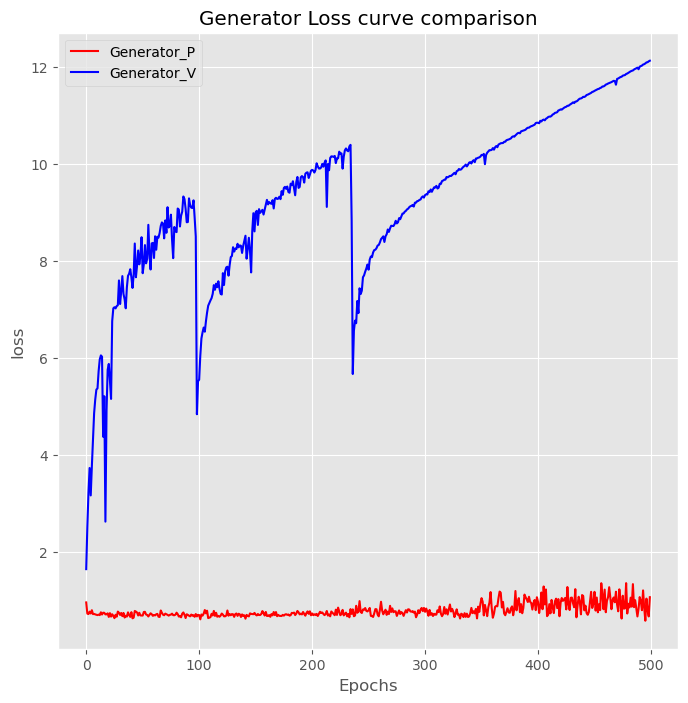

<Figure size 640x480 with 0 Axes>

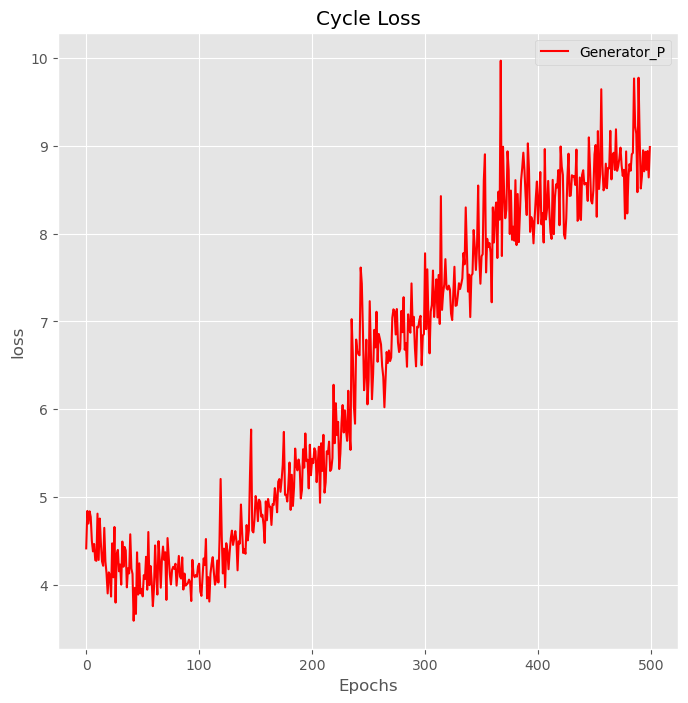

<Figure size 640x480 with 0 Axes>

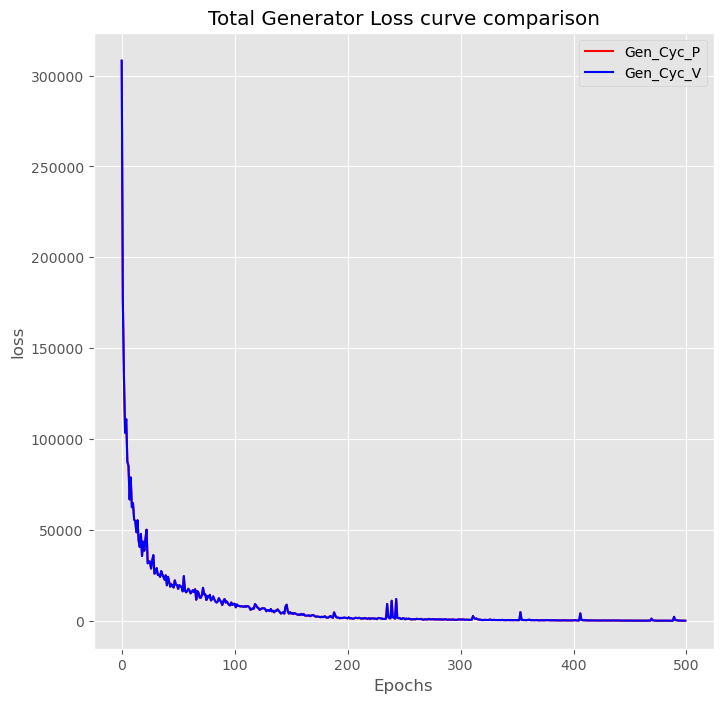

<Figure size 640x480 with 0 Axes>

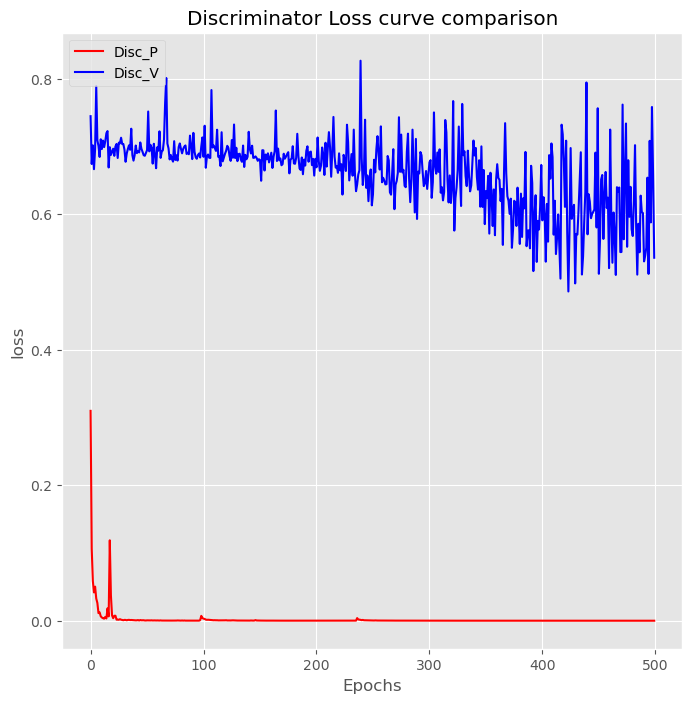

<Figure size 640x480 with 0 Axes>

In [65]:
plt.figure(figsize=(8, 8))
plt.title("Generator Loss curve comparison")
plt.plot(genGLoss, label="Generator_P", color = "red")
plt.plot(genFLoss, label="Generator_V", color = "blue")
plt.xlabel("Epochs")
plt.ylabel("loss")
plt.legend();
plt.show()
plt.savefig(output_path+'Generator_loss_M'+str(model_size)+'.png', bbox_inches='tight')
#plt.clf()


plt.figure(figsize=(8, 8))
plt.title("Cycle Loss")
plt.plot(cycLoss, label="Generator_P", color = "red")
plt.xlabel("Epochs")
plt.ylabel("loss")
plt.legend();
plt.show()
plt.savefig(output_path+'Cycle_loss_M'+str(model_size)+'.png', bbox_inches='tight')
#plt.clf()


plt.figure(figsize=(8, 8))
plt.title("Total Generator Loss curve comparison")
plt.plot(totgenGLoss, label="Gen_Cyc_P", color = "red")
plt.plot(totgenFLoss, label="Gen_Cyc_V", color = "blue")
plt.xlabel("Epochs")
plt.ylabel("loss")
plt.legend();
plt.show()
plt.savefig(output_path+'Gen_Cyc_loss_M'+str(model_size)+'.png', bbox_inches='tight')
#plt.clf()

plt.figure(figsize=(8, 8))
plt.title("Discriminator Loss curve comparison")
plt.plot(discXLoss, label="Disc_P", color = "red")
plt.plot(discYLoss, label="Disc_V", color = "blue")
plt.xlabel("Epochs")
plt.ylabel("loss")
plt.legend();
plt.show()
plt.savefig(output_path+'Discriminator_loss_M'+str(model_size)+'.png', bbox_inches='tight')
#plt.clf()

In [30]:
print(1)

1


In [31]:
ex_pots_1 = next(iter(train_pots))
ex_pots_2 = next(iter(train_pots))
ex_pots_3 = next(iter(train_pots))

ex_to_vai_1 = generator_g(ex_pots_1)
ex_to_vai_2 = generator_g(ex_pots_2)
ex_to_vai_3 = generator_g(ex_pots_3)

ex_pots = []
ex_to_vai = []

ex_pots.append(ex_pots_1)
ex_pots.append(ex_pots_2)
ex_pots.append(ex_pots_3)

ex_to_vai.append(ex_to_vai_1)
ex_to_vai.append(ex_to_vai_2)
ex_to_vai.append(ex_to_vai_3)

In [32]:
from skimage.transform import resize

#segmenting
unet_v = tf.keras.models.load_model('Selected_Images/Subset_Clipped_Vaihingen/UNet_Vaihingen.h5')  # creates a HDF5 file 'my_model.h5'

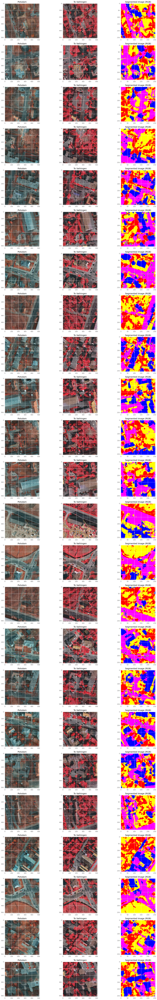

In [64]:
import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np

# Assuming you have the necessary image arrays: ex_pots, ex_to_vai, and unet_v

# Define the figure size
plt.figure(figsize=(18, 96))

# Define the number of rows and columns
num_rows = 24
num_cols = 3

# Define the color palette
color_palette = np.array([
    [0, 0, 0],         # Background (Black)
    [255, 0, 0],       # Category 1 (Red)
    [0, 255, 0],       # Category 2 (Green)
    [0, 0, 255],       # Category 3 (Blue)
    [255, 255, 0],     # Category 4 (Yellow)
    [255, 0, 255],     # Category 5 (Magenta)
    [0, 255, 255]      # Category 6 (Cyan)
], dtype=np.uint8)

# Loop through each row and plot the images
for i in range(num_rows):
    # Plot the first image
    plt.subplot(num_rows, num_cols, 3*i+1)
    plt.imshow(ex_pots[i // 8][i % 8] * 0.5 + 0.5)
    plt.title("Potsdam")
    
    # Plot the second image
    plt.subplot(num_rows, num_cols, 3*i+2)
    temp_vai = ex_to_vai[i // 8][i % 8] * 0.5 + 0.5
    plt.imshow(temp_vai)
    plt.title("To Vaihingen")
    
    # Plot the segmented image using color palette
    plt.subplot(num_rows, num_cols, 3*i+3)
    resized_image = tf.image.resize(temp_vai, size=(256, 256))
    expanded_image = tf.expand_dims(resized_image, axis=0)
    segmented_image = unet_v(expanded_image)
    
    # Apply color palette to segmented image
    np_segmented_image = segmented_image[0].numpy()
    argmax_image = np.argmax(np_segmented_image, axis=-1)
    rgb_image = color_palette[argmax_image]
    
    plt.imshow(rgb_image)
    plt.title("Segmented Image (RGB)")

plt.tight_layout()

plt.subplots_adjust(hspace=0.2)


# Save the figure
plt.savefig(output_path + 'Demo_P2V_V2P_Ex.png', bbox_inches='tight')
